## Libraries and Data Downloading

In [1]:
import os
import glob
import pickle
import pandas as pd
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
import re
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
nltk.download('punkt')
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import nltk
nltk.download('punkt')
nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
import os
from nltk.stem import WordNetLemmatizer


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Downloading the Clinical trials 2021 collection

# Load the Dataframe

In [2]:
from google.colab import drive
import pandas as pd
import pickle

# Mount Google Drive
drive.mount('/content/drive')

# Specify the path to the pickle file within your Google Drive
pickle_file_path = '/content/drive/My Drive/extracted_information.pkl'

# Load the data from the pickle file into a Pandas DataFrame
with open(pickle_file_path, 'rb') as file:
    df = pd.DataFrame(pickle.load(file))

# Now 'df' is a Pandas DataFrame that contains the data from the pickle file.
# You can use standard Pandas DataFrame operations to analyze and manipulate the data.
# For example, you can print the first few rows of the DataFrame:
display(df.head(500000))
print(f'Total number of rows: {len(df)}')


Mounted at /content/drive


,nct_id,brief_title,official_title,brief_summary,detailed_description,study_type,study_design_info_primary_purpose,condition,intervention_intervention_type,intervention_intervention_name,...,trials_keyword,condition_browse_mesh_term,intervention_browse_mesh_term,eligibility_criteria,eligibility_inclusion_criteria,eligibility_exclusion_criteria,eligibility_gender,eligibility_minimum_age,eligibility_maximum_age,eligibility_healthy_volunteers
0,NCT00976963,Single Dose Monurol for Treatment of Acute Cys...,Single Dose Monurol for Treatment of Acute Cys...,Urinary tract infecton (UTI) is a very common ...,Procedures subjects will undergo once they hav...,Interventional,Treatment,Urinary Tract Infection,Drug,Fosfomycin,...,UTI,Urinary Tract Infections,Fosfomycin,Inclusion Criteria:\r\n\r\n - Non pr...,:\r\n\r\n - Non pregnant women in go...,":\r\n\r\n - Pregnant, lactating, or ...",Female,18 Years,45 Years,Accepts Healthy Volunteers
1,NCT00976573,"Carboplatin, Paclitaxel, and Bevacizumab With ...","A Randomized Phase II Trial of Carboplatin, Pa...",This randomized phase II trial is studying how...,OBJECTIVES:\r\n\r\n Primary\r\n\r\n ...,Interventional,Treatment,Melanoma (Skin),Biological,bevacizumab,...,"Stage IV Skin Melanoma, recurrent melanoma",Melanoma,"Paclitaxel, Bevacizumab, Carboplatin, Everolimus",Inclusion Criteria:\r\n\r\n - Histol...,:\r\n\r\n - Histologic proof of stag...,- Prior treatment with agents disrupting vasc...,All,18 Years,N/A,No
2,NCT00971139,Implementing Online Patient-Provider Communica...,Implementing Online Patient-Provider Communica...,"This interdisciplinary, international collabor...",A rapidly growing research literature document...,Interventional,Supportive Care,Cancer,Behavioral,Access to an OPPC service,...,"Online patient-provider communication, Organiz...",,,Inclusion Criteria:\r\n\r\n - 18 yea...,:\r\n\r\n - 18 years of age.\r\n\r\n...,:\r\n\r\n - Excluded are patients wh...,All,18 Years,N/A,No
3,NCT00977769,Carbetocin Versus Oxytocin and Hemodynamic Eff...,"Hemodynamic Effects of Carbetocin 100 µg, Oxyt...",A randomized double-blind trial of oxytocin 5 ...,Healthy pregnant women sheduled for elective c...,Interventional,Treatment,"Effects of; Anesthesia, in Pregnancy",Drug,carbetocin 100 µg,...,"cesarean delivery, blood pressure, cardiac output",,"Oxytocin, Carbetocin",Inclusion Criteria:\r\n\r\n - Health...,:\r\n\r\n - Healthy pregnant women f...,:\r\n\r\n - Bleeding disorders\r\n\r...,Female,18 Years,50 Years,No
4,NCT00976924,Clinical Test of Blood Glucose Test Strips,Clinical Test of Blood Glucose Test Strips,Blood glucose test strips are tested with the ...,,Interventional,Diagnostic,Diabetes,Device,blood glucose monitor,...,blood glucose,,,Inclusion Criteria:\r\n\r\n - The pa...,:\r\n\r\n - The patients with blood ...,:\r\n\r\n - The patients with blood ...,All,22 Years,78 Years,Accepts Healthy Volunteers
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,NCT00026312,"Isotretinoin With or Without Dinutuximab, Alde...",Phase III Randomized Study of Chimeric Antibod...,This partially randomized phase III trial stud...,PRIMARY OBJECTIVES:\r\n\r\n I. Determine ...,Interventional,Treatment,Localized Resectable Neuroblastoma,Biological,Aldesleukin,...,,Neuroblastoma,"Vitamin A, Aldesleukin, Interleukin-2, Tretino...",Inclusion Criteria:\r\n\r\n - All pa...,:\r\n\r\n - All patients must be dia...,,All,N/A,30 Years,No
9996,NCT00025714,Study of Specimens Obtained During Epilepsy Su...,Research Study of Specimens Obtained During Ep...,This study will collect brain tissue samples f...,This is a protocol to perform research studies...,Observational,,Epilepsy,,,...,"Serotonin Receptor, Cell Culture, Temporal Lob...",Epilepsy,,- INCLUSION CRITERIA:\r\n\r\n To be el...,:\r\n\r\n To be eligible for entry into...,:\r\n\r\n Candidates will be excluded i...,All,4 Years,N/A,No
9997,NCT00023751,Surgery With or Without Chemotherapy and Radia...,A Phase II Study of Local

Total number of rows: 10000


# Data pre-processing


In [3]:
# Set display options to show all columns and rows
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.max_rows', None)     # Show all rows

df.describe()

,nct_id,brief_title,official_title,brief_summary,detailed_description,study_type,study_design_info_primary_purpose,condition,intervention_intervention_type,intervention_intervention_name,location,trials_keyword,condition_browse_mesh_term,intervention_browse_mesh_term,eligibility_criteria,eligibility_inclusion_criteria,eligibility_exclusion_criteria,eligibility_gender,eligibility_minimum_age,eligibility_maximum_age,eligibility_healthy_volunteers
count,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000
unique,10000,9961,9681,9937,6197,5,10,3220,11,6807,5053,7518,984,2603,9894,9829,9333,4,100,185,3
top,NCT00976963,[Trial of device that is not approved or clear...,,,,Interventional,Treatment,Healthy,Drug,,,,,,,,,All,18 Years,N/A,No
freq,1,21,269,21,3741,8339,6187,271,5355,1102,1486,2150,1273,4980,25,31,371,8581,6193,5047,7737


### Dealing with missing values

In [4]:
missing_values = df.isnull().sum()
print(missing_values)

nct_id                               0
brief_title                          0
official_title                       0
brief_summary                        0
detailed_description                 0
study_type                           0
study_design_info_primary_purpose    0
condition                            0
intervention_intervention_type       0
intervention_intervention_name       0
location                             0
trials_keyword                       0
condition_browse_mesh_term           0
intervention_browse_mesh_term        0
eligibility_criteria                 0
eligibility_inclusion_criteria       0
eligibility_exclusion_criteria       0
eligibility_gender                   0
eligibility_minimum_age              0
eligibility_maximum_age              0
eligibility_healthy_volunteers       0
dtype: int64


No missing values in our dataset.

### Cleaning the data

In [5]:
# Clean text data by removing irrelevant information and standardizing formats
def clean_text(text):
    # Convert to lowercase
    text = text.lower()
    # Remove special characters, punctuation, and non-alphanumeric characters
    text = re.sub(r'[^a-zA-Z0-9\s]', '', text)
    # Remove numbers
    text = re.sub(r'\d+', '', text)
    # Remove stopwords
    text = ' '.join([word for word in text.split() if word.lower() not in stop_words])
    #Remove extra whitespaces
    cleaned_text = re.sub(r'\s+', ' ', text)
    return cleaned_text

# Apply cleaning function to relevant columns
columns_to_clean = ['brief_title', 'official_title', 'brief_summary', 'detailed_description']
for col in columns_to_clean:
    df[col] = df[col].apply(clean_text)


In [6]:
# Tokenize and quantify term occurrences
def tokenize_and_count_terms(text):
    tokens = word_tokenize(text.lower())
    return FreqDist(tokens)

# Apply tokenization to the 'detailed_description' column
df['tokenized_terms'] = df['detailed_description'].apply(tokenize_and_count_terms)

## Analylizing the data

### Count how many times a terms appears in the dataframe

In [7]:
# Replace 'target_terms' with a list of specific terms you want to search for
target_terms = ['pregnant', 'heart attack', 'diabetes']

# Initialize a dictionary to store term counts
term_counts = {}

# Loop through each target term and count occurrences in 'detailed_description'
for target_term in target_terms:
    term_count = df['detailed_description'].str.lower().groupby(level=0).apply(lambda x: x.str.contains(target_term.lower()).sum()).sum()
    term_counts[target_term] = term_count
    print(f"The term '{target_term}' appears {term_count} times in the 'detailed_description'.")

# Display the overall term counts
print("\nOverall Term Counts:")
for term, count in term_counts.items():
    print(f"The term '{term}' appears {count} times.")


The term 'pregnant' appears 109 times in the 'detailed_description'.
The term 'heart attack' appears 21 times in the 'detailed_description'.
The term 'diabetes' appears 261 times in the 'detailed_description'.

Overall Term Counts:
The term 'pregnant' appears 109 times.
The term 'heart attack' appears 21 times.
The term 'diabetes' appears 261 times.


### Display unique values of a DataFrame

In [8]:
# Display unique values in pivotal fields
pivotal_fields = ['condition', 'intervention_intervention_type']
for field in pivotal_fields:
    unique_values = df[field].unique()
    print(f"Unique values in '{field}':")
    print(unique_values)


Unique values in 'condition':
['Urinary Tract Infection' 'Melanoma (Skin)' 'Cancer' ...
 'Intraocular Melanoma' 'Diamond Blackfan Anemia'
 'Localized Resectable Neuroblastoma']
Unique values in 'intervention_intervention_type':
['Drug' 'Biological' 'Behavioral' 'Device' '' 'Radiation' 'Procedure'
 'Dietary Supplement' 'Other' 'Genetic' 'Diagnostic Test']


### Display some information

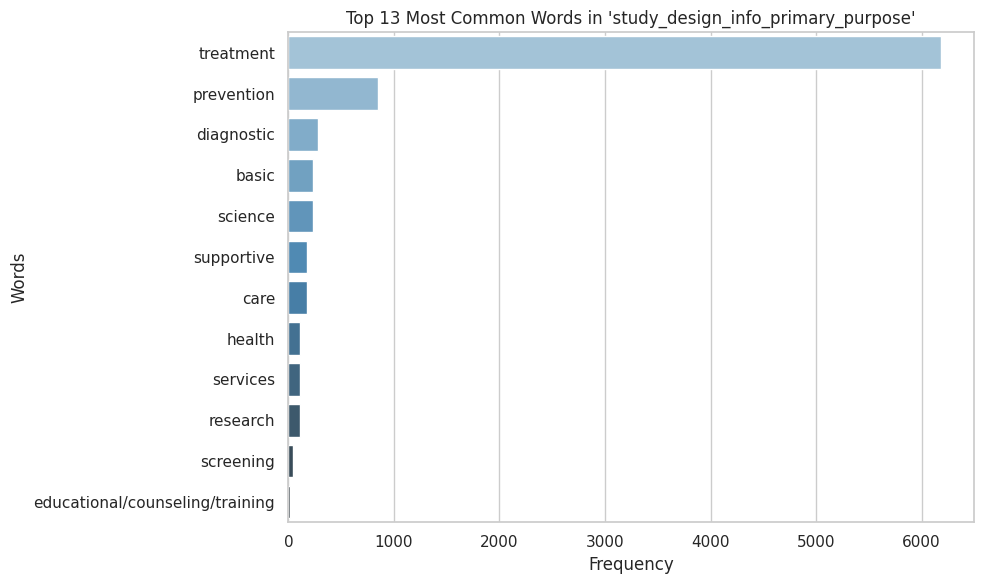

In [9]:
def plot_top_words_frequency(data_frame, column_name, top_n=13):
    # Extract text from the specified column
    text_data = " ".join(data_frame[column_name])

    # Tokenization and preprocessing
    tokens = word_tokenize(text_data.lower())
    stop_words = set(stopwords.words("english"))
    tokens = [word for word in tokens if word not in stop_words and word not in string.punctuation]

    # Calculate word frequencies
    word_freq = Counter(tokens)

    # Get the top N most common words
    top_words = word_freq.most_common(top_n)

    # Extract words and frequencies for plotting
    words = [word for word, freq in top_words]
    frequencies = [freq for word, freq in top_words]

    # Set seaborn style
    sns.set(style="whitegrid")

    # Create a bar chart using Seaborn
    plt.figure(figsize=(10, 6))
    sns.barplot(x=frequencies, y=words, palette="Blues_d")
    plt.xlabel("Frequency")
    plt.ylabel("Words")
    plt.title(f"Top {top_n} Most Common Words in '{column_name}'")
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function to plot top word frequencies from the 'text_column'
plot_top_words_frequency(df, 'study_design_info_primary_purpose')

### % of documents for each medical condition

In [10]:
condition_counts = df['condition'].value_counts()
total_documents = len(df)
# Setting the number of top medical conditions to display
top_n_conditions = 25
# Getting the top N medical conditions by count
top_conditions = condition_counts.head(top_n_conditions)
# Displaying the percentage of documents for the top N medical conditions
print("Percentage of Documents Related to Top Medical Conditions:")
print(top_conditions / total_documents * 100)


Percentage of Documents Related to Top Medical Conditions:
Healthy                      2.71
Breast Cancer                2.24
HIV Infections               1.51
Asthma                       1.36
Schizophrenia                0.98
Prostate Cancer              0.97
Hypertension                 0.94
Obesity                      0.93
Colorectal Cancer            0.80
Diabetes Mellitus, Type 2    0.76
Lung Cancer                  0.70
Diabetes                     0.67
Coronary Artery Disease      0.67
Leukemia                     0.66
Pain                         0.61
Type 2 Diabetes Mellitus     0.58
Rheumatoid Arthritis         0.57
Influenza                    0.57
Depression                   0.54
Type 2 Diabetes              0.53
Alzheimer's Disease          0.47
Ovarian Cancer               0.46
Multiple Myeloma             0.46
Cancer                       0.43
Head and Neck Cancer         0.42
Name: condition, dtype: float64


### Displaying more information of the dataset

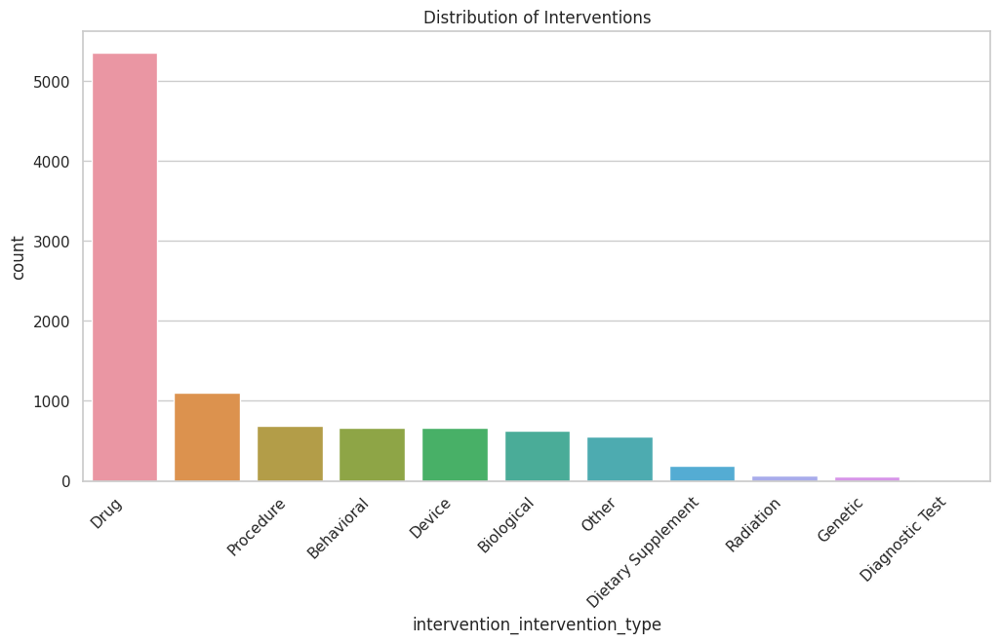

In [11]:
plt.figure(figsize=(12, 6))
sns.countplot(x='intervention_intervention_type', data=df, order=df['intervention_intervention_type'].value_counts().index)
plt.xticks(rotation=45, ha='right')
plt.title('Distribution of Interventions')
plt.show()

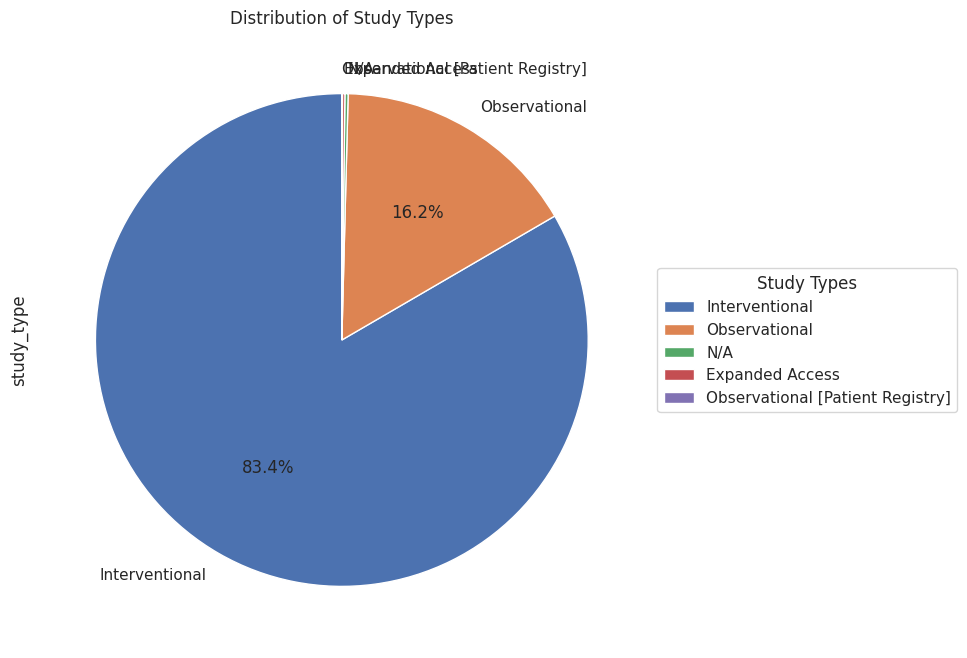

In [12]:
study_type_column = 'study_type'

plt.figure(figsize=(10, 8))
pie = df[study_type_column].value_counts().plot.pie(
    autopct=lambda p: f'{p:.1f}%' if p > 5 else '',  # Display percentages for slices larger than 5%
    startangle=90,
    textprops=dict(rotation_mode="anchor"),
    labeldistance=1.1
)
plt.title('Distribution of Study Types')

# Manually place the legend outside the pie chart
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", title="Study Types")

plt.show()




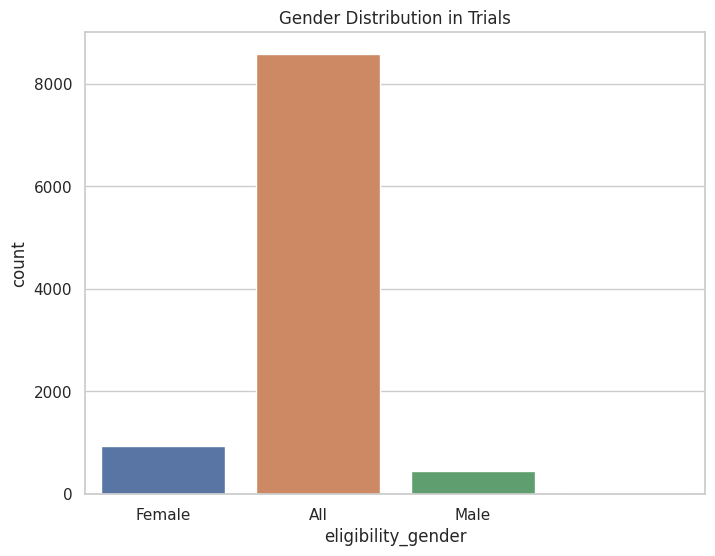

In [13]:
gender_column = 'eligibility_gender'

plt.figure(figsize=(8, 6))
sns.countplot(x=gender_column, data=df)
plt.title('Gender Distribution in Trials')
plt.show()


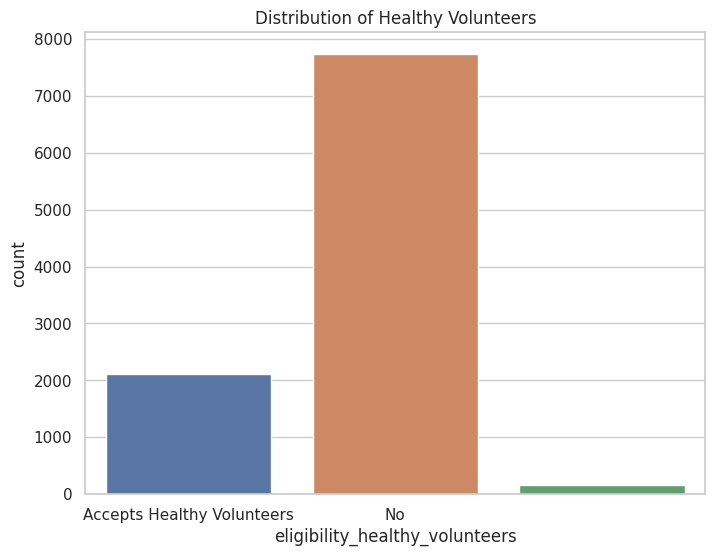

In [14]:
df['eligibility_healthy_volunteers'].fillna('Unknown', inplace=True)
plt.figure(figsize=(8, 6))
sns.countplot(x='eligibility_healthy_volunteers', data=df)
plt.title('Distribution of Healthy Volunteers')
plt.show()


# Indexing the collection

In [15]:
!pip install python-terrier
import pyterrier as pt

if not pt.started():
    pt.init(boot_packages=["com.github.terrierteam:terrier-prf:-SNAPSHOT"])

from pyterrier.measures import *


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.6/107.6 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 kB 6.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.0/318.0 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.8/48.8 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.2/41.2 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 16.9 MB/s eta 0:00:00
  Preparing metadata (setup.

PyTerrier 0.10.0 has loaded Terrier 5.8 (built by craigm on 2023-11-01 18:05) and terrier-helper 0.0.8



Creating a field to index per document

> Indented block



In [16]:
df.rename(columns={'nct_id': 'docno'}, inplace=True)
display(df.keys())

# Merging the titles, and the summary in one text
columns_to_combine = ['brief_title', 'official_title', 'brief_summary']
df['text'] = df[columns_to_combine].apply(lambda row: ' '.join(map(str, row)), axis=1)

display(df)



Index(['docno', 'brief_title', 'official_title', 'brief_summary',
       'detailed_description', 'study_type',
       'study_design_info_primary_purpose', 'condition',
       'intervention_intervention_type', 'intervention_intervention_name',
       'location', 'trials_keyword', 'condition_browse_mesh_term',
       'intervention_browse_mesh_term', 'eligibility_criteria',
       'eligibility_inclusion_criteria', 'eligibility_exclusion_criteria',
       'eligibility_gender', 'eligibility_minimum_age',
       'eligibility_maximum_age', 'eligibility_healthy_volunteers',
       'tokenized_terms'],
      dtype='object')

,docno,brief_title,official_title,brief_summary,detailed_description,study_type,study_design_info_primary_purpose,condition,intervention_intervention_type,intervention_intervention_name,location,trials_keyword,condition_browse_mesh_term,intervention_browse_mesh_term,eligibility_criteria,eligibility_inclusion_criteria,eligibility_exclusion_criteria,eligibility_gender,eligibility_minimum_age,eligibility_maximum_age,eligibility_healthy_volunteers,tokenized_terms,text
0,NCT00976963,single dose monurol treatment acute cystitis,single dose monurol treatment acute cystitis,urinary tract infecton uti common problem youn...,procedures subjects undergo read signed consen...,Interventional,Treatment,Urinary Tract Infection,Drug,Fosfomycin,University of Washington,UTI,Urinary Tract Infections,Fosfomycin,Inclusion Criteria:\r\n\r\n - Non pr...,:\r\n\r\n - Non pregnant women in go...,":\r\n\r\n - Pregnant, lactating, or ...",Female,18 Years,45 Years,Accepts Healthy Volunteers,"{'procedures': 1, 'subjects': 1, 'undergo': 1,...",single dose monurol treatment acute cystitis s...
1,NCT00976573,carboplatin paclitaxel bevacizumab without eve...,randomized phase ii trial carboplatin paclitax...,randomized phase ii trial studying well carbop...,objectives primary assess whether sufficient p...,Interventional,Treatment,Melanoma (Skin),Biological,bevacizumab,Mayo Clinic Scottsdale,"Stage IV Skin Melanoma, recurrent melanoma",Melanoma,"Paclitaxel, Bevacizumab, Carboplatin, Everolimus",Inclusion Criteria:\r\n\r\n - Histol...,:\r\n\r\n - Histologic proof of stag...,- Prior treatment with agents disrupting vasc...,All,18 Years,N/A,No,"{'objectives': 1, 'primary': 1, 'assess': 2, '...",carboplatin paclitaxel bevacizumab without eve...
2,NCT00971139,implementing online patientprovider communicat...,implementing online patientprovider communicat...,interdisciplinary international collaboration ...,rapidly growing research literature documents ...,Interventional,Supportive Care,Cancer,Behavioral,Access to an OPPC service,Oslo University Hospital - Rikshospitalet,"Online patient-provider communication, Organiz...",,,Inclusion Criteria:\r\n\r\n - 18 yea...,:\r\n\r\n - 18 years of age.\r\n\r\n...,:\r\n\r\n - Excluded are patients wh...,All,18 Years,N/A,No,"{'rapidly': 1, 'growing': 1, 'research': 4, 'l...",implementing online patientprovider communicat...
3,NCT00977769,carbetocin versus oxytocin hemodynamic effects,hemodynamic effects carbetocin g oxytocin u pl...,randomized doubleblind trial oxytocin u carbet...,healthy pregnant women sheduled elective cesar...,Interventional,Treatment,"Effects of; Anesthesia, in Pregnancy",Drug,carbetocin 100 µg,Division of Anaesthesia and Intensive Care Med...,"cesarean delivery, blood pressure, cardiac output",,"Oxytocin, Carbetocin",Inclusion Criteria:\r\n\r\n - Health...,:\r\n\r\n - Healthy pregnant women f...,:\r\n\r\n - Bleeding disorders\r\n\r...,Female,18 Years,50 Years,No,"{'healthy': 1, 'pregnant': 1, 'women': 1, 'she...",carbetocin versus oxytocin hemodynamic effects...
4,NCT00976924,clinical test blood glucose test strips,clinical test blood glucose test strips,blood glucose test strips tested test meters t...,,Interventional,Diagnostic,Diabetes,Device,blood glucose monitor,Tianjin Medical University general hospital,blood glucose,,,Inclusion Criteria:\r\n\r\n - The pa...,:\r\n\r\n - The patients with blood ...,:\r\n\r\n - The patients with blood ...,All,22 Years,78 Years,Accepts Healthy Volunteers,{},clinical test blood glucose test strips clinic...
5,NCT00976781,identifying gaps diagnosis management hepatitis c,identifying gaps diagnosis management hepatitis c,purpose study identify gaps diagnosing managin...,,Observational,,Hepatitis C,,,Henry Ford Hospital,,Hepatitis A,,Inclusion Criteria:\r\n\r\n - Every ...,:\r\n\r\n - Every patient diagnosed ...,:\r\n\r\n - Patients younger than 18...,All,18 Years,N/A,No,{},identifying gaps diagnosis management hepatiti...
6,NCT00975052,study effects sitagliptin mk metformi

Now we will index the dataframe's documents. The index, with all its data structures, is written into a directory called `index`.

In [17]:
# Allows to set a property in Terrier’s global properties configuration
pt.set_properties({
    "termpipelines": "PorterStemmer, stopwords"
})

# Index the text, record the docnos, and the raw text as metadata
pd_indexer = pt.DFIndexer("./content/index", overwrite=True)
index = pd_indexer.index(df["text"], df[["docno"]])


Printing some statistics

In [18]:
# Load the index, print the statistics
index = pt.IndexFactory.of(index)
print(index.getCollectionStatistics().toString())
print(index.getMetaIndex().getKeys())

Number of documents: 10000
Number of terms: 24001
Number of postings: 389828
Number of fields: 0
Number of tokens: 657070
Field names: []
Positions:   false

['docno']


## Getting term statistics:


In [19]:
index.getLexicon()["cancer"].toString()

'term206 Nt=1670 TF=5351 maxTF=19 @{0 66179 0}'

### Searching an Index

In [20]:
# Setting the retrieval pipeline and model
br = pt.BatchRetrieve(index, wmodel="TF_IDF")
br.search("heart attack")

,qid,docid,docno,rank,score,query
0,1,6005,NCT00353067,0,10.632107,heart attack
1,1,3600,NCT00719914,1,10.619692,heart attack
2,1,9826,NCT00025766,2,10.512459,heart attack
3,1,9372,NCT00093197,3,10.434740,heart attack
4,1,9095,NCT00099411,4,9.828974,heart attack
5,1,2004,NCT00965120,5,9.438063,heart attack
6,1,3717,NCT00714961,6,9.408921,heart attack
7,1,1673,NCT00965393,7,9.245574,heart attack
8,1,9260,NCT00094198,8,9.244875,heart attack
9,1,9477,NCT00097591,9,9.039005,heart attack


### Experiment with Query Language

In [21]:
# Creating a BatchRetrieve model using BM25
ret_model = pt.BatchRetrieve(index, wmodel="BM25")

# Experimentations with different query formulations
terms_query1 = "pregnant^2.3 women"
print(terms_query1)
display(ret_model.search(terms_query1).head(5))

terms_query2 = "women^2.3 pregnant"
print(terms_query2)
display(ret_model.search(terms_query2).head(5))

terms_query3 = "women pregnant^2.3"
print(terms_query3)
display(ret_model.search(terms_query3).head(5))

terms_query4 = "+pregnant women"
print(terms_query4)
display(ret_model.search(terms_query4).head(5))

terms_query5 = "+women +pregnant"
print(terms_query5)
display(ret_model.search(terms_query5).head(5))

terms_query6 = "-pregnant +women"
print(terms_query6)
display(ret_model.search(terms_query6).head(5))

# Experimentations with different query formulations
terms_query7 = "heart attack treatment"
print(terms_query7)
display(ret_model.search(terms_query7).head(5))

terms_query8 = "diabetes prevention"
print(terms_query8)
display(ret_model.search(terms_query8).head(5))

terms_query9 = "cancer clinical trials"
print(terms_query9)
display(ret_model.search(terms_query9).head(5))

terms_query10 = "+heart attack -treatment"
print(terms_query10)
display(ret_model.search(terms_query10).head(5))

terms_query11 = "lung disease +treatment"
print(terms_query11)
display(ret_model.search(terms_query11).head(5))




pregnant^2.3 women


,qid,docid,docno,rank,score,query
0,1,6524,NCT00865683,0,16.297846,pregnant^2.3 women
1,1,5011,NCT00905125,1,16.084402,pregnant^2.3 women
2,1,8672,NCT00401505,2,15.802708,pregnant^2.3 women
3,1,1009,NCT00519766,3,15.483605,pregnant^2.3 women
4,1,2773,NCT00159536,4,15.130689,pregnant^2.3 women


women^2.3 pregnant


,qid,docid,docno,rank,score,query
0,1,6524,NCT00865683,0,13.370736,women^2.3 pregnant
1,1,8672,NCT00401505,1,13.361978,women^2.3 pregnant
2,1,5011,NCT00905125,2,13.056514,women^2.3 pregnant
3,1,2773,NCT00159536,3,12.656853,women^2.3 pregnant
4,1,1009,NCT00519766,4,12.568817,women^2.3 pregnant


women pregnant^2.3


,qid,docid,docno,rank,score,query
0,1,6524,NCT00865683,0,16.297846,women pregnant^2.3
1,1,5011,NCT00905125,1,16.084402,women pregnant^2.3
2,1,8672,NCT00401505,2,15.802708,women pregnant^2.3
3,1,1009,NCT00519766,3,15.483605,women pregnant^2.3
4,1,2773,NCT00159536,4,15.130689,women pregnant^2.3


+pregnant women


,qid,docid,docno,rank,score,query
0,1,6524,NCT00865683,0,20.266566,+pregnant women
1,1,8672,NCT00401505,1,19.922355,+pregnant women
2,1,5011,NCT00905125,2,19.906119,+pregnant women
3,1,1009,NCT00519766,3,19.162570,+pregnant women
4,1,2773,NCT00159536,4,18.981631,+pregnant women


+women +pregnant


,qid,docid,docno,rank,score,query
0,1,6524,NCT00865683,0,20.266566,+women +pregnant
1,1,8672,NCT00401505,1,19.922355,+women +pregnant
2,1,5011,NCT00905125,2,19.906119,+women +pregnant
3,1,1009,NCT00519766,3,19.162570,+women +pregnant
4,1,2773,NCT00159536,4,18.981631,+women +pregnant


-pregnant +women


,qid,docid,docno,rank,score,query
0,1,5523,NCT00356707,0,7.460867,-pregnant +women
1,1,8317,NCT00405782,1,7.460114,-pregnant +women
2,1,1406,NCT00514254,2,7.375513,-pregnant +women
3,1,5138,NCT00900458,3,7.311445,-pregnant +women
4,1,7189,NCT00844181,4,7.271024,-pregnant +women


heart attack treatment


,qid,docid,docno,rank,score,query
0,1,3600,NCT00719914,0,20.434262,heart attack treatment
1,1,9826,NCT00025766,1,19.964851,heart attack treatment
2,1,6005,NCT00353067,2,19.231844,heart attack treatment
3,1,9372,NCT00093197,3,18.853257,heart attack treatment
4,1,2004,NCT00965120,4,18.106493,heart attack treatment


diabetes prevention


,qid,docid,docno,rank,score,query
0,1,1506,NCT00518167,0,14.050396,diabetes prevention
1,1,9676,NCT00097292,1,12.991473,diabetes prevention
2,1,2894,NCT00153088,2,12.431841,diabetes prevention
3,1,9190,NCT00095654,3,12.366138,diabetes prevention
4,1,9706,NCT00097786,4,12.215152,diabetes prevention


cancer clinical trials


,qid,docid,docno,rank,score,query
0,1,5053,NCT00907738,0,8.831486,cancer clinical trials
1,1,5819,NCT00359645,1,8.762928,cancer clinical trials
2,1,1740,NCT00965718,2,8.757119,cancer clinical trials
3,1,4930,NCT00907166,3,8.757119,cancer clinical trials
4,1,5118,NCT00900562,4,8.686192,cancer clinical trials


+heart attack -treatment


,qid,docid,docno,rank,score,query
0,1,6005,NCT00353067,0,19.231844,+heart attack -treatment
1,1,9372,NCT00093197,1,18.853257,+heart attack -treatment
2,1,9095,NCT00099411,2,17.766761,+heart attack -treatment
3,1,3717,NCT00714961,3,17.019288,+heart attack -treatment
4,1,9260,NCT00094198,4,16.722555,+heart attack -treatment


lung disease +treatment


,qid,docid,docno,rank,score,query
0,1,72,NCT00970801,0,12.627777,lung disease +treatment
1,1,9481,NCT00094094,1,12.396966,lung disease +treatment
2,1,7325,NCT00846781,2,12.396612,lung disease +treatment
3,1,58,NCT00977561,3,11.600791,lung disease +treatment
4,1,8056,NCT00621361,4,11.177813,lung disease +treatment


# Loading queries and qrels

using ir_datasets to obtain the queries and the qrels
https://ir-datasets.com/

In [22]:
# Queries
!pip install --upgrade ir_datasets
dataset = pt.get_dataset('irds:clinicaltrials/2021/trec-ct-2022')
queries = dataset.get_topics(variant='text')
display(queries)


path_to_qrels = '/content/drive/My Drive/clc_qrels2021.txt'
qrels = pd.read_csv(path_to_qrels, names=['qid','Q0','docno','label'],sep=" ",header=None)
qrels = qrels.drop(columns=['Q0'])
qrels["qid"] = qrels["qid"].astype(str)
qrels["docno"] = qrels["docno"].astype(str)
display(qrels.head(2))

[INFO] [starting] https://www.trec-cds.org/topics2022.xml
[INFO] [finished] https://www.trec-cds.org/topics2022.xml: [00:00] [32.4kB] [671kB/s]


,qid,query
0,1,a 19 year old male came to clinic with some se...
1,2,a 32 year old woman comes to the hospital with...
2,3,a 51 year old man comes to the office complain...
3,4,a 66 year old woman comes to the office due to...
4,5,a 23 year old man comes to the emergency depar...
5,6,a 61 year old man comes to the clinic due to n...
6,7,a 3 year old girl is brought to the clinic by ...
7,8,a 7 month old boy is brought to emergency by h...
8,9,a 67 year old woman comes to the clinic due to...
9,10,a 19 year old girl comes to the clinic due to ...


,qid,docno,label
0,1,NCT00002569,1
1,1,NCT00002620,1


In [23]:
print("Column names in the queries DataFrame:")
print(queries.columns.tolist())


Column names in the queries DataFrame:
['qid', 'query']


In [24]:
queries = queries.rename(columns={'query': 'original_query'})
#changing the name so we can differentiate more clearly between original and preprocessed queries

In [25]:
!pip install keybert


  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 28.3 MB/s eta 0:00:00
  Created wheel for keybert: filename=keybert-0.8.3-py3-none-any.whl size=39124 sha256=c2a11634e064e62326d2d1b4849b8a9d6b1973b9d2f4e39aeef883dc1bcf4813
  Stored in directory: /root/.cache/pip/wheels/70/88/07/1a3bc11fd1dd5f89924a02dcbca89a3015e25e8faa31f904dc
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125923 sha256=638ff72b8c12b214b44e3158d69a0afcb32d9a52bd7408d2ec484a9f760a9212
  Stored in directory: /root/.cache/pip/wheels/62/f2/10/1e606fd5f02395388f74e7462910fe851042f97238cbbd902f
Successfully built keybert sentence-transformers


In [26]:
from keybert import KeyBERT

kw_model = KeyBERT()

def keybert_extraction(query, kw_model, keyphrase_ngram_range=(1, 2), stop_words='english',
                       use_maxsum=False, nr_candidates=25, top_n=20):
    keywords_list = kw_model.extract_keywords(query, keyphrase_ngram_range=keyphrase_ngram_range,
                                              stop_words=stop_words, use_maxsum=use_maxsum,
                                              nr_candidates=nr_candidates, top_n=top_n)

    # Extract keywords from the list
    keywords = [item[0] for item in keywords_list]

    # Join keywords into a single text input
    text_input = ', '.join(keywords)

    return text_input

# Apply keyBERT extraction to the 'text' column of your queries dataframe
queries['keybert_topics'] = queries['original_query'].apply(lambda x: keybert_extraction(x, kw_model))

# Display the queries dataframe with the new 'keybert_topics' column
display(queries)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


.gitattributes:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

data_config.json:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

train_script.py:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

,qid,original_query,keybert_topics
0,1,a 19 year old male came to clinic with some se...,"serum testosterone, testosterone level, testos..."
1,2,a 32 year old woman comes to the hospital with...,"reveals endometrium, endometrium gestational, ..."
2,3,a 51 year old man comes to the office complain...,"hemochromatosis, case hemochromatosis, serum f..."
3,4,a 66 year old woman comes to the office due to...,"joint pain, joints bilaterally, pain moderatel..."
4,5,a 23 year old man comes to the emergency depar...,"light headedness, dizzy passed, harsh systolic..."
5,6,a 61 year old man comes to the clinic due to n...,"pleural effusion, thoracentesis biopsy, pleura..."
6,7,a 3 year old girl is brought to the clinic by ...,"fgfr3 gene, fibroblast growth, consistent acho..."
7,8,a 7 month old boy is brought to emergency by h...,"feces anus, burst feces, submucosal ganglia, b..."
8,9,a 67 year old woman comes to the clinic due to...,"choking dysphagia, esophagus outpouching, uppe..."
9,10,a 19 year old girl comes to the clinic due to ...,"wrist mass, swelling wrist, left wrist, wrist ..."


In [27]:
!pip install flair


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 388.3/388.3 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.7/19.7 MB 29.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 45.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 202.6/202.6 kB 15.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/11.9 MB 36.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.9/270.9 kB 21.5 MB/s eta 0:00:00
  Created wheel for langdetect: filename=langdetect-1.0.9-p

In [28]:
!pip install --upgrade urllib3


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.6/104.6 kB 1.8 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.26.18
    Uninstalling urllib3-1.26.18:
      Successfully uninstalled urllib3-1.26.18
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
botocore 1.34.19 requires urllib3<2.1,>=1.25.4; python_version >= "3.10", but you have urllib3 2.1.0 which is incompatible.
flair 0.13.1 requires urllib3<2.0.0,>=1.0.0, but you have urllib3 2.1.0 which is incompatible.


We also try doing the keyBert with Flair Embeddings

In [29]:
from flair.embeddings import TransformerDocumentEmbeddings

roberta = TransformerDocumentEmbeddings('roberta-base')
kw_model = KeyBERT(model=roberta)

queries['keybert_topics2'] = queries['original_query'].apply(lambda x: keybert_extraction(x,kw_model))

display(queries)

config.json:   0%|          | 0.00/481 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/499M [00:00<?, ?B/s]

,qid,original_query,keybert_topics,keybert_topics2
0,1,a 19 year old male came to clinic with some se...,"serum testosterone, testosterone level, testos...","old male, serum testosterone, pubic hair, enga..."
1,2,a 32 year old woman comes to the hospital with...,"reveals endometrium, endometrium gestational, ...","appendectomy complicated, significant appendec..."
2,3,a 51 year old man comes to the office complain...,"hemochromatosis, case hemochromatosis, serum f...","c282y mutation, homozygosity c282y, old man, c..."
3,4,a 66 year old woman comes to the office due to...,"joint pain, joints bilaterally, pain moderatel...","distal interphalangeal, interphalangeal joints..."
4,5,a 23 year old man comes to the emergency depar...,"light headedness, dizzy passed, harsh systolic...","septal hypertrophy, systolic murmur, examinati..."
5,6,a 61 year old man comes to the clinic due to n...,"pleural effusion, thoracentesis biopsy, pleura...","hypertension hypercholesteremia, effusion nodu..."
6,7,a 3 year old girl is brought to the clinic by ...,"fgfr3 gene, fibroblast growth, consistent acho...","old girl, mutation fibroblast, reveals autosom..."
7,8,a 7 month old boy is brought to emergency by h...,"feces anus, burst feces, submucosal ganglia, b...","rectum rectosigmoid, rectosigmoid area, rectos..."
8,9,a 67 year old woman comes to the clinic due to...,"choking dysphagia, esophagus outpouching, uppe...","dysphagia cough, esophagus outpouching, hypert..."
9,10,a 19 year old girl comes to the clinic due to ...,"wrist mass, swelling wrist, left wrist, wrist ...","old girl, normal patient, relationship male, c..."


Now we analyse which keyBert extraction method is better for our goal:

In [30]:
def calculate_average_keywords(df, column_name):
    # Split the comma-separated keywords and count them
    keyword_counts = df[column_name].str.split(',').apply(len)
    # Calculate the average
    average_keywords = keyword_counts.mean()
    return average_keywords

# Calculate averages for both methods
average_keywords_regular_keybert = calculate_average_keywords(queries, 'keybert_topics')
average_keywords_flair_keybert = calculate_average_keywords(queries, 'keybert_topics2')

# Display the results
print("Average number of keywords for regular KeyBERT:", average_keywords_regular_keybert)
print("Average number of keywords for KeyBERT with Flair embeddings:", average_keywords_flair_keybert)


Average number of keywords for regular KeyBERT: 20.0
Average number of keywords for KeyBERT with Flair embeddings: 20.0


Since they both have the same average number of keywords for each query, this doesn't give us any insights to which one to use.

In [31]:
# Function to calculate the overlap between two keyword sets
def calculate_overlap(df, column1, column2):
    set1 = set(df[column1].str.split(',').explode())
    set2 = set(df[column2].str.split(',').explode())
    intersection = set1.intersection(set2)
    union = set1.union(set2)
    overlap_percentage = len(intersection) / len(union) * 100 if len(union) > 0 else 0
    return overlap_percentage

# Calculate overlap for both methods
overlap_percentage = calculate_overlap(queries, 'keybert_topics', 'keybert_topics2')

# Display the results
print(f"Overlap between regular KeyBERT and KeyBERT with Flair embeddings: {overlap_percentage:.2f}%")

Overlap between regular KeyBERT and KeyBERT with Flair embeddings: 25.34%


In [32]:
# Function to get overlapping and unique keywords with corresponding query and common keywords
def get_overlap_and_unique_keywords(df, column1, column2):
    overlap_keywords = []

    for index, row in df.iterrows():
        set1 = set(row[column1].split(', '))
        set2 = set(row[column2].split(', '))

        overlap = set1.intersection(set2)
        unique1 = set1 - overlap
        unique2 = set2 - overlap

        overlap_keywords.append({
            'qid': row['qid'],
            'query': row['original_query'],
            'common_keywords': ', '.join(overlap),
            'unique_method1_keywords': ', '.join(unique1),
            'unique_method2_keywords': ', '.join(unique2)
        })

    return pd.DataFrame(overlap_keywords)

# Get overlapping and unique keywords
overlap_keywords_df = get_overlap_and_unique_keywords(queries, 'keybert_topics', 'keybert_topics2')

# Display the results in a table
display(overlap_keywords_df)


,qid,query,common_keywords,unique_method1_keywords,unique_method2_keywords
0,1,a 19 year old male came to clinic with some se...,"ml hormonal, clinic sexual, testosterone, ultr...","normal ultrasound, examination pubic, coffee s...","dl low, evaluation, girlfriend, engaged relati..."
1,2,a 32 year old woman comes to the hospital with...,"serum hcg, pelvic, pelvic ultrasound, endometr...","vaginal spotting, regular menses, menses, spot...","appendectomy, male, days medical, multiple mal..."
2,3,a 51 year old man comes to the office complain...,"homozygosity c282y, libido patient, case hemoc...","diagnosed, hemochromatosis, transferrin satura...","mm hg, kg, illicit drug, complaining fatigue, ..."
3,4,a 66 year old woman comes to the office due to...,"morning stiffness, patient pain, sclerosis ost...","used tylenol, joint, joints, pain moderately, ...","hypertension, sensation bone, firm nodules, ac..."
4,5,a 23 year old man comes to the emergency depar...,"conditions patient, edema echocardiography, me...","echocardiography shows, syncope, dizzy passed,...","murmur lungs, physical activity, activity expe..."
5,6,a 61 year old man comes to the clinic due to n...,"pleura, bloody thoracentesis, effusion nodular...","left lung, disease smokes, decreased breath, l...","medical conditions, peptic ulcer, ulcer diseas..."
6,7,a 3 year old girl is brought to the clinic by ...,"achondroplasia father, consistent achondroplas...","fgfr3, receptor fgfr3, achondroplasia, autosom...","clinic, dominant, examinations, examinations u..."
7,8,a 7 month old boy is brought to emergency by h...,"patient constipation, rectum rectosigmoid, nar...","bowel sounds, bowel movements, feces, abdomina...","rectosigmoid, days patient, digital rectal, re..."
8,9,a 67 year old woman comes to the clinic due to...,"normal barium, dysphagia cough, portion esopha...","swallow, episode choking, lower throat, throat...","hg patient, dyslipidemia osteoarthritis, dysli..."
9,10,a 19 year old girl comes to the clinic due to ...,"clinic, wrist transilluminates, normal patient...","left handed, mass dorsal, dorsal wrist, mass n...","male, uses, ago, comes, examination, noticed, ..."


We displayed the common words between the two methods as well as the unique words for each method, finally, we will rely on manual evaluation of the previously displayed keywords extraction as well as the following for 5 queries, then we will decide which method is providing more accurate and relative keywords for our search engine.

In [33]:
# Function for manual evaluation
def manual_evaluation(df, num_queries_to_evaluate=5):
    for i in range(num_queries_to_evaluate):
        query_row = df.sample(1).iloc[0]
        query_id = query_row['qid']
        query_text = query_row['original_query']
        keywords_method1 = query_row['keybert_topics'].split(', ')
        keywords_method2 = query_row['keybert_topics2'].split(', ')

        print(f"\nQuery ID: {query_id}")
        print(f"Query Text: {query_text}")
        print(f"Keywords (Method 1): {', '.join(keywords_method1)}")
        print(f"Keywords (Method 2): {', '.join(keywords_method2)}")


# Perform manual evaluation for a subset of queries
manual_evaluation(queries, num_queries_to_evaluate=5)


Query ID: 4
Query Text: a 66 year old woman comes to the office due to joint pain in the hands and periodic morning stiffness that lasts less than 15 minutes the pain is moderately severe and worsens with daily activity the patient used tylenol with minimal relief past medical history is notable for hypertension and hypercholesteremia physical examination shows firm nodules over the distal interphalangeal joints bilaterally the patient has pain in her knees as well the knees are stiff in the morning for less than 30 minutes and become worse with climbing stairs she has some sensation of bone friction during activity x ray shows narrowing of the joint space subchondral bone sclerosis and osteophyte formation along the joints
Keywords (Method 1): joint pain, joints bilaterally, pain moderately, bone sclerosis, knees stiff, pain knees, morning stiffness, joints, sclerosis osteophyte, interphalangeal joints, pain hands, tylenol, tylenol minimal, osteophyte, patient pain, bone friction, us

After analysing, we decide to go with the regular keyBERT keyword extraction.

# Putting everything together

## Evaluation with bm5



In [34]:
queries = queries.rename(columns={'keybert_topics': 'query'})


In [35]:
bm25 = pt.BatchRetrieve(index, wmodel="BM25", properties={"termpipelines": "Stopwords,PorterStemmer"})

# Retrieve documents for res1
res1 = bm25.transform(queries[['qid', 'query']])
res1['rank'] = res1.groupby('qid')['score'].rank(ascending=False, method='first')

In [36]:
# Finalize DataFrames
res1 = res1[['qid', 'docid', 'docno', 'score', 'rank', 'query']]

In [37]:
####Relevance labels of 2 are considered as relevant
metrics_eval = [
 RR(rel=2)@1000,
 P(rel=2)@1 , P(rel=2)@5 , P(rel=2)@10 , P(rel=2)@25 , P(rel=2)@30, P(rel=2)@75,
 Rprec(rel=2),
 R(rel=2)@10, R(rel=2)@25,
]

In [38]:
## Perform retrieval
#Evaluate
results_all_des = pt.Experiment(
    [res1],
    queries,
    qrels,
    eval_metrics=metrics_eval,
    names=["MYRUN"],
    baseline=0,
    perquery = False,
)
display(results_all_des)


,name,Rprec(rel=2),P(rel=2)@1,P(rel=2)@5,P(rel=2)@10,P(rel=2)@25,P(rel=2)@30,P(rel=2)@75,R(rel=2)@10,R(rel=2)@25,RR(rel=2)@1000,Rprec(rel=2) +,Rprec(rel=2) -,Rprec(rel=2) p-value,P(rel=2)@1 +,P(rel=2)@1 -,P(rel=2)@1 p-value,P(rel=2)@5 +,P(rel=2)@5 -,P(rel=2)@5 p-value,P(rel=2)@10 +,P(rel=2)@10 -,P(rel=2)@10 p-value,P(rel=2)@25 +,P(rel=2)@25 -,P(rel=2)@25 p-value,P(rel=2)@30 +,P(rel=2)@30 -,P(rel=2)@30 p-value,P(rel=2)@75 +,P(rel=2)@75 -,P(rel=2)@75 p-value,R(rel=2)@10 +,R(rel=2)@10 -,R(rel=2)@10 p-value,R(rel=2)@25 +,R(rel=2)@25 -,R(rel=2)@25 p-value,RR(rel=2)@1000 +,RR(rel=2)@1000 -,RR(rel=2)@1000 p-value
0,MYRUN,0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000678,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [39]:
display(res1.head(25))
### Create Condesed list
Con_aggr_res = pd.merge(res1, qrels, on=["qid",'docno'],how="left")
display(Con_aggr_res.head(25))
# display(Con_aggr_res.head(25))
Con_aggr_res = Con_aggr_res[Con_aggr_res['label'].notna()]

eval = pt.Utils.evaluate(Con_aggr_res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)
display(eval)

,qid,docid,docno,score,rank,query
0,1,7179,NCT00847951,17.977767,1.0,"serum testosterone, testosterone level, testos..."
1,1,2335,NCT00150163,16.688060,2.0,"serum testosterone, testosterone level, testos..."
2,1,6419,NCT00868205,16.105267,3.0,"serum testosterone, testosterone level, testos..."
3,1,2897,NCT00155961,16.035931,4.0,"serum testosterone, testosterone level, testos..."
4,1,443,NCT00975611,15.765446,5.0,"serum testosterone, testosterone level, testos..."
5,1,9235,NCT00097305,15.642518,6.0,"serum testosterone, testosterone level, testos..."
6,1,3949,NCT00555087,15.428988,7.0,"serum testosterone, testosterone level, testos..."
7,1,3596,NCT00710606,15.222169,8.0,"serum testosterone, testosterone level, testos..."
8,1,3176,NCT00716482,14.941787,9.0,"serum testosterone, testosterone level, testos..."
9,1,4951,NCT00909376,14.693876,10.0,"serum testosterone, testosterone level, testos..."


,qid,docid,docno,score,rank,query,label
0,1,7179,NCT00847951,17.977767,1.0,"serum testosterone, testosterone level, testos...",NaN
1,1,2335,NCT00150163,16.688060,2.0,"serum testosterone, testosterone level, testos...",NaN
2,1,6419,NCT00868205,16.105267,3.0,"serum testosterone, testosterone level, testos...",NaN
3,1,2897,NCT00155961,16.035931,4.0,"serum testosterone, testosterone level, testos...",NaN
4,1,443,NCT00975611,15.765446,5.0,"serum testosterone, testosterone level, testos...",NaN
5,1,9235,NCT00097305,15.642518,6.0,"serum testosterone, testosterone level, testos...",NaN
6,1,3949,NCT00555087,15.428988,7.0,"serum testosterone, testosterone level, testos...",NaN
7,1,3596,NCT00710606,15.222169,8.0,"serum testosterone, testosterone level, testos...",NaN
8,1,3176,NCT00716482,14.941787,9.0,"serum testosterone, testosterone level, testos...",NaN
9,1,4951,NCT00909376,14.693876,10.0,"serum testosterone, testosterone level, testos...",NaN


<ipython-input-39-d898eee890c9>:8: DeprecationWarning: Call to deprecated function (or staticmethod) evaluate. (Use pt.Evaluate instead) -- Deprecated since version 0.9.
  eval = pt.Utils.evaluate(Con_aggr_res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)


{'AP@1000': 0.0012573587106085283,
 'P@5': 0.048000000000000015,
 'P@10': 0.024000000000000007}

## Evaluation with bm25 + rm3



In [40]:
## Set a retrieval model or pipeline
bm25 = pt.BatchRetrieve(index, wmodel="BM25", properties={"termpipelines" : "Stopwords,PorterStemmer"})
query_verbose_rm3  = bm25.transform(queries[['qid','query']]) >> pt.rewrite.RM3(index, fb_terms=20, fb_docs=5) >> bm25

## Evaluation Measures
####Relevance labels of 2 are considered as relevant
metrics_eval = [
 AP(rel=2)@1000,
 RR(rel=2)@1000,
 P(rel=2)@1 , P(rel=2)@5 , P(rel=2)@10 , P(rel=2)@25 , P(rel=2)@30, P(rel=2)@75,
 Rprec(rel=2),
 nDCG@5 , nDCG@10, nDCG@25,
 R(rel=2)@10, R(rel=2)@25,
 Bpref(rel=2)
]

## Perform retrieval
#Evaluate
results_all_des = pt.Experiment(
    [bm25, query_verbose_rm3,],
    queries,
    qrels,
    eval_metrics=metrics_eval,
    names=["bm25",
           'bm25+rm3'
           ],
    baseline=0,
    perquery = False,
    correction='b',
    highlight= 'color',
    # filter_by_topics = False,
    # filter_by_qrels = False
)
display(results_all_des)

res = bm25.transform(queries[['qid','query']])
display(res.head(5))
eval = pt.Utils.evaluate(res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)
display(eval)


<ipython-input-40-0b014de5d36a>:3: DeprecationWarning: Coercion of a dataframe into a transformer is deprecated; use a pt.Transformer.from_df() instead
  query_verbose_rm3  = bm25.transform(queries[['qid','query']]) >> pt.rewrite.RM3(index, fb_terms=20, fb_docs=5) >> bm25


,name,Rprec(rel=2),Bpref(rel=2),P(rel=2)@1,P(rel=2)@5,P(rel=2)@10,P(rel=2)@25,P(rel=2)@30,P(rel=2)@75,R(rel=2)@10,R(rel=2)@25,nDCG@5,nDCG@10,nDCG@25,AP(rel=2)@1000,RR(rel=2)@1000,Rprec(rel=2) +,Rprec(rel=2) -,Rprec(rel=2) p-value,Rprec(rel=2) reject,Rprec(rel=2) p-value corrected,Bpref(rel=2) +,Bpref(rel=2) -,Bpref(rel=2) p-value,Bpref(rel=2) reject,Bpref(rel=2) p-value corrected,P(rel=2)@1 +,P(rel=2)@1 -,P(rel=2)@1 p-value,P(rel=2)@1 reject,P(rel=2)@1 p-value corrected,P(rel=2)@5 +,P(rel=2)@5 -,P(rel=2)@5 p-value,P(rel=2)@5 reject,P(rel=2)@5 p-value corrected,P(rel=2)@10 +,P(rel=2)@10 -,P(rel=2)@10 p-value,P(rel=2)@10 reject,P(rel=2)@10 p-value corrected,P(rel=2)@25 +,P(rel=2)@25 -,P(rel=2)@25 p-value,P(rel=2)@25 reject,P(rel=2)@25 p-value corrected,P(rel=2)@30 +,P(rel=2)@30 -,P(rel=2)@30 p-value,P(rel=2)@30 reject,P(rel=2)@30 p-value corrected,P(rel=2)@75 +,P(rel=2)@75 -,P(rel=2)@75 p-value,P(rel=2)@75 reject,P(rel=2)@75 p-value corrected,R(rel=2)@10 +,R(rel=2)@10 -,R(rel=2)@10 p-value,R(rel=2)@10 reject,R(rel=2)@10 p-value corrected,R(rel=2)@25 +,R(rel=2)@25 -,R(rel=2)@25 p-value,R(rel=2)@25 reject,R(rel=2)@25 p-value corrected,nDCG@5 +,nDCG@5 -,nDCG@5 p-value,nDCG@5 reject,nDCG@5 p-value corrected,nDCG@10 +,nDCG@10 -,nDCG@10 p-value,nDCG@10 reject,nDCG@10 p-value corrected,nDCG@25 +,nDCG@25 -,nDCG@25 p-value,nDCG@25 reject,nDCG@25 p-value corrected,AP(rel=2)@1000 +,AP(rel=2)@1000 -,AP(rel=2)@1000 p-value,AP(rel=2)@1000 reject,AP(rel=2)@1000 p-value corrected,RR(rel=2)@1000 +,RR(rel=2)@1000 -,RR(rel=2)@1000 p-value,RR(rel=2)@1000 reject,RR(rel=2)@1000 p-value corrected
0,bm25,0.000140,0.002230,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000007,0.000678,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan,nan,nan,nan,False,nan
1,bm25+rm3,0.000000,0.003531,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000021,0.000720,0.000000,1.000000,0.322223,False,0.644447,5.000000,5.000000,0.230017,False,0.460033,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,0.000000,0.000000,nan,False,nan,5.000000,8.000000,0.185522,False,0.371044,5.000000,8.000000,0.847916,False,1.000000


,qid,docid,docno,rank,score,query
0,1,7179,NCT00847951,0,17.977767,"serum testosterone, testosterone level, testos..."
1,1,2335,NCT00150163,1,16.688060,"serum testosterone, testosterone level, testos..."
2,1,6419,NCT00868205,2,16.105267,"serum testosterone, testosterone level, testos..."
3,1,2897,NCT00155961,3,16.035931,"serum testosterone, testosterone level, testos..."
4,1,443,NCT00975611,4,15.765446,"serum testosterone, testosterone level, testos..."


<ipython-input-40-0b014de5d36a>:38: DeprecationWarning: Call to deprecated function (or staticmethod) evaluate. (Use pt.Evaluate instead) -- Deprecated since version 0.9.
  eval = pt.Utils.evaluate(res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)


{'AP@1000': 3.756153339453365e-06, 'P@5': 0.0, 'P@10': 0.0}

In [41]:
display(res.head(25))
Con_aggr_res = pd.merge(res, qrels, on=["qid",'docno'],how="left")# Creating Condesed list

display(Con_aggr_res.head(25))
# displaying(Con_aggr_res.head(25))
Con_aggr_res = Con_aggr_res[Con_aggr_res['label'].notna()]

eval = pt.Utils.evaluate(Con_aggr_res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)
display(eval)

,qid,docid,docno,rank,score,query
0,1,7179,NCT00847951,0,17.977767,"serum testosterone, testosterone level, testos..."
1,1,2335,NCT00150163,1,16.688060,"serum testosterone, testosterone level, testos..."
2,1,6419,NCT00868205,2,16.105267,"serum testosterone, testosterone level, testos..."
3,1,2897,NCT00155961,3,16.035931,"serum testosterone, testosterone level, testos..."
4,1,443,NCT00975611,4,15.765446,"serum testosterone, testosterone level, testos..."
5,1,9235,NCT00097305,5,15.642518,"serum testosterone, testosterone level, testos..."
6,1,3949,NCT00555087,6,15.428988,"serum testosterone, testosterone level, testos..."
7,1,3596,NCT00710606,7,15.222169,"serum testosterone, testosterone level, testos..."
8,1,3176,NCT00716482,8,14.941787,"serum testosterone, testosterone level, testos..."
9,1,4951,NCT00909376,9,14.693876,"serum testosterone, testosterone level, testos..."


,qid,docid,docno,rank,score,query,label
0,1,7179,NCT00847951,0,17.977767,"serum testosterone, testosterone level, testos...",NaN
1,1,2335,NCT00150163,1,16.688060,"serum testosterone, testosterone level, testos...",NaN
2,1,6419,NCT00868205,2,16.105267,"serum testosterone, testosterone level, testos...",NaN
3,1,2897,NCT00155961,3,16.035931,"serum testosterone, testosterone level, testos...",NaN
4,1,443,NCT00975611,4,15.765446,"serum testosterone, testosterone level, testos...",NaN
5,1,9235,NCT00097305,5,15.642518,"serum testosterone, testosterone level, testos...",NaN
6,1,3949,NCT00555087,6,15.428988,"serum testosterone, testosterone level, testos...",NaN
7,1,3596,NCT00710606,7,15.222169,"serum testosterone, testosterone level, testos...",NaN
8,1,3176,NCT00716482,8,14.941787,"serum testosterone, testosterone level, testos...",NaN
9,1,4951,NCT00909376,9,14.693876,"serum testosterone, testosterone level, testos...",NaN


<ipython-input-41-fe13c7d26a21>:8: DeprecationWarning: Call to deprecated function (or staticmethod) evaluate. (Use pt.Evaluate instead) -- Deprecated since version 0.9.
  eval = pt.Utils.evaluate(Con_aggr_res, qrels,metrics=[AP@1000,P@5,P@10],perquery=False)


{'AP@1000': 0.0012573587106085283,
 'P@5': 0.048000000000000015,
 'P@10': 0.024000000000000007}